<a href="https://colab.research.google.com/github/edwin-yan/Passion-Fruit-Disease-Detection/blob/andrew/Train_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SET UP
## Mounting

Note that this assumes that your google drive folder has the same document layout. You must modify if that is not the case.


From your root Google Drive directory create a couple of folders:
* `JHU/DNN/FinalProject/Train_Images`
* `JHU/DNN/FinalProject/Test_Images` 

with Train and test images unzipped in those directories



In [ ]:
# set GPU to nividia and display for confirmation
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)

# if unsuccessful, manual execution
if gpu_info.find('unsuccessful') >= 0:
  print('Use Runtime → "Change runtime type" menu option to execute manually.')
else:
  print(gpu_info)

Mon Nov  8 14:41:42 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# **TODO:** GLOBAL VARIABLE set to `True` if using colab and `False` if not!

In [ ]:
IS_COLAB = True 

# **TODO:** CHANGE `IMG_DIR` if your google drive directory is different

In [ ]:
if IS_COLAB:
  from google.colab import drive
  drive.mount('/content/drive')
  IMG_PATH = '/content/drive/MyDrive/JHU/DNN/FinalProject'
else:
  IMG_PATH= '.'

Mounted at /content/drive


In [ ]:
TRAIN_PATH = f'{IMG_PATH}/Train.csv'
TEST_PATH = f'{IMG_PATH}/Test.csv'

In [ ]:
import time

t0 = time.time()

# !!TODO: you don't have to do this if you aren't using colab and your images are in a different directory!!
Copy test images from google drive to colab storage for speed:

Takes about 3 mins

In [ ]:
! mkdir /content/datasets
! mkdir /content/datasets/Train

In [ ]:
! ls

datasets  drive  sample_data


In [ ]:
! cp -r {IMG_PATH}/Train_Images /content/datasets/Train
# rename directory to match Edwin's
! mv /content/datasets/Train/Train_Images /content/datasets/Train/images

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Imports

In [ ]:
# Clone from repo and cd into repo
!git clone https://github.com/edwin-yan/Passion-Fruit-Disease-Detection

# Change directory
%cd Passion-Fruit-Disease-Detection

# Checkout specific branch
!git checkout andrew

Cloning into 'Passion-Fruit-Disease-Detection'...
remote: Enumerating objects: 336, done.
remote: Counting objects: 100% (336/336), done.
remote: Compressing objects: 100% (265/265), done.
remote: Total 336 (delta 138), reused 198 (delta 56), pack-reused 0
Receiving objects: 100% (336/336), 156.75 MiB | 15.03 MiB/s, done.
Resolving deltas: 100% (138/138), done.
/content/Passion-Fruit-Disease-Detection
Branch 'andrew' set up to track remote branch 'andrew' from 'origin'.
Switched to a new branch 'andrew'


In [ ]:
!ls

Baseline_Model.ipynb					      Models
Eager_few_shot_od_training_colab_DNN_FINAL.ipynb	      README.md
EDA_colab.ipynb						      Test.csv
EDA.ipynb						      Test_Images
helper.py						      Train.csv
inference_colab.ipynb					      Train_Images
Interactive_eager_few_shot_od_training_colab_DNN_FINAL.ipynb  yolo5Input


In [ ]:
import pandas as pd
from helper import plot_sample_images, plot_sample_images_multi

In [ ]:
df_train, df_test = pd.read_csv(TRAIN_PATH), pd.read_csv(TEST_PATH)
print(f"Training Data Shape:  {df_train.shape}\nTest Data Shape:      {df_test.shape}")

Training Data Shape:  (3906, 6)
Test Data Shape:      (931, 1)


In [ ]:
df_train.Image_ID.value_counts().head(10)

ID_OYN556Y0    5
ID_LZI2KVVE    5
ID_XEMG90OT    5
ID_AF7K88JS    5
ID_M34YFAR2    5
ID_1HHF5LHI    4
ID_66FB5PP0    4
ID_5LSWR9I5    4
ID_IX4625NU    4
ID_1TJA8V5E    4
Name: Image_ID, dtype: int64

In [ ]:
df_train['class'].value_counts()

fruit_healthy      1638
fruit_woodiness    1246
fruit_brownspot    1022
Name: class, dtype: int64

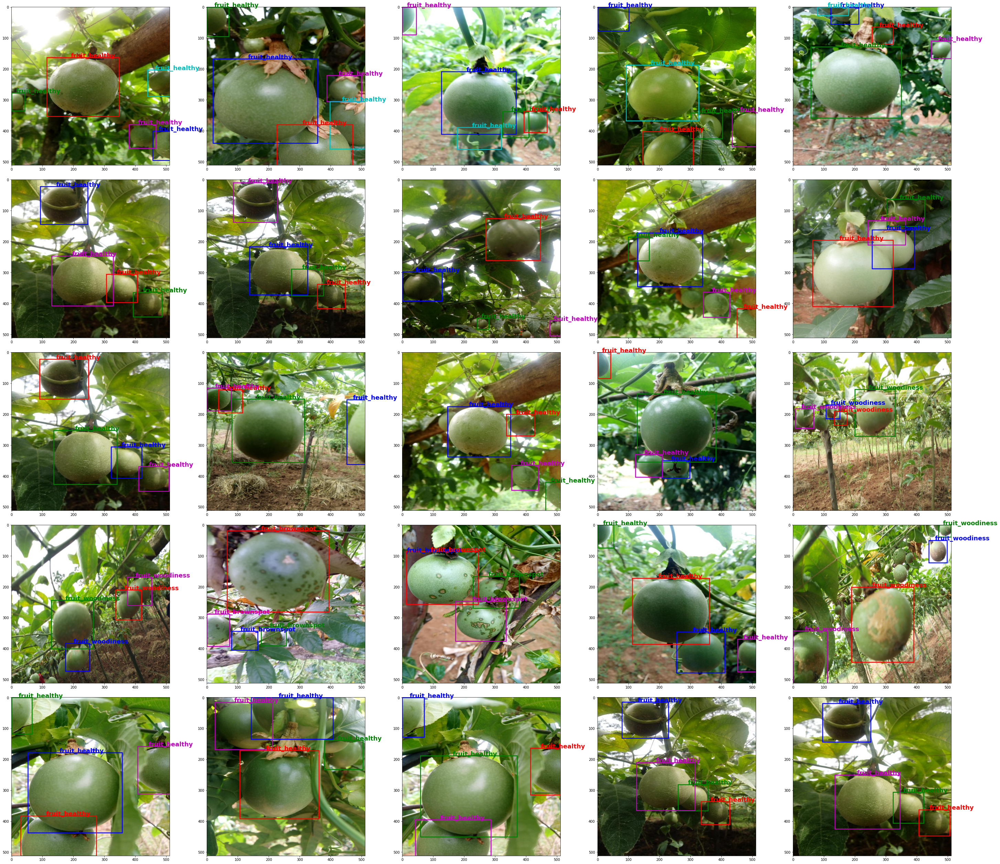

In [ ]:
plot_sample_images_multi(df_train,dir_path=IMG_PATH)

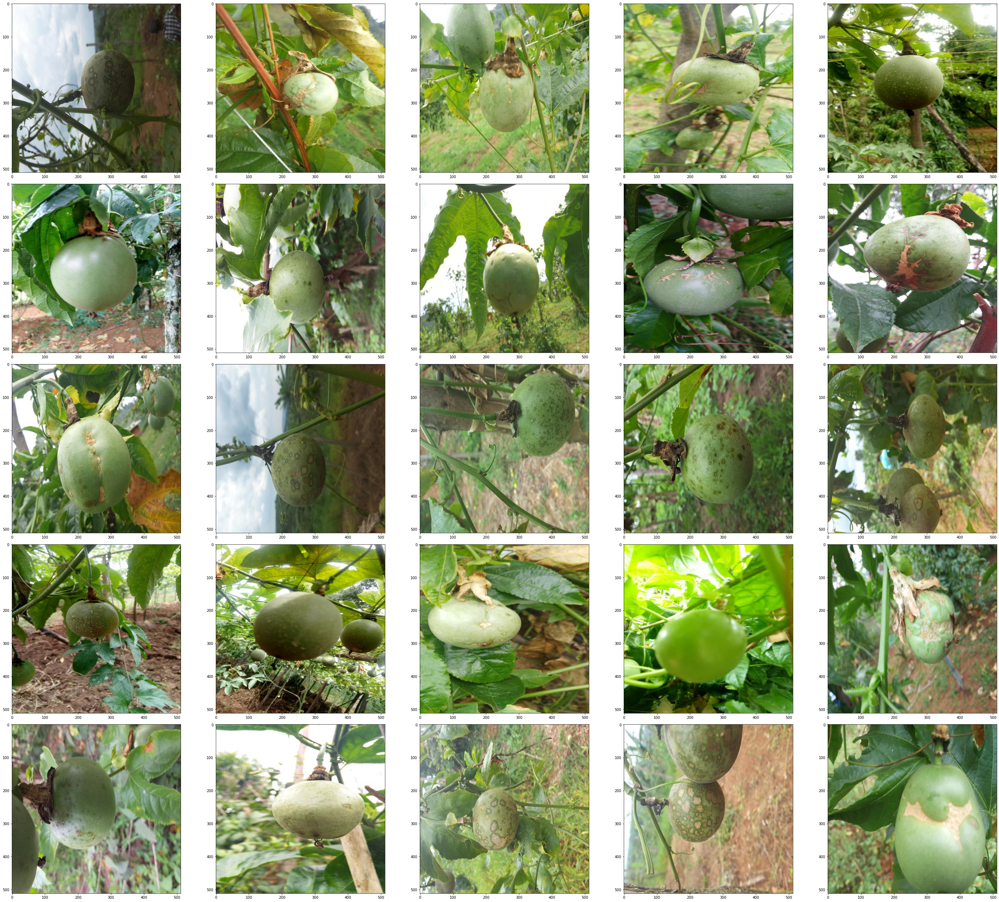

In [ ]:
plot_sample_images_multi(df_test, show_label=False, is_train=False,dir_path=IMG_PATH)

# Convert to YOLO 5 annotation format

https://roboflow.com/formats/yolov5-pytorch-txt

Each image has one txt file with a single line for each bounding box. The format of each row is 

`class_id center_x center_y width height`

ASSUMPTION: Image size is 512 x 512: https://zindi.africa/competitions/makerere-passion-fruit-disease-detection-challenge/data
```
The dataset contains about 4000 images resized to 512x512.
```

In [ ]:
IMG_HEIGHT = 512
IMG_WIDTH = 512

In [ ]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height
0,ID_007FAIEI,fruit_woodiness,87.0,87.5,228.0,311.0
1,ID_00G8K1V3,fruit_brownspot,97.5,17.5,245.0,354.5
2,ID_00WROUT9,fruit_brownspot,156.5,209.5,248.0,302.5
3,ID_00ZJEEK3,fruit_healthy,125.0,193.0,254.5,217.0
4,ID_018UIENR,fruit_brownspot,79.5,232.5,233.5,182.0


Normalize Data:

In [ ]:
df_train['xmin'] = df_train['xmin']/IMG_WIDTH
df_train['ymin'] = df_train['ymin']/IMG_HEIGHT
df_train['width'] = df_train['width']/IMG_WIDTH
df_train['height'] = df_train['height']/IMG_HEIGHT

In [ ]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height
0,ID_007FAIEI,fruit_woodiness,0.169922,0.170898,0.445312,0.607422
1,ID_00G8K1V3,fruit_brownspot,0.190430,0.034180,0.478516,0.692383
2,ID_00WROUT9,fruit_brownspot,0.305664,0.409180,0.484375,0.590820
3,ID_00ZJEEK3,fruit_healthy,0.244141,0.376953,0.497070,0.423828
4,ID_018UIENR,fruit_brownspot,0.155273,0.454102,0.456055,0.355469


Add columns for center

In [ ]:
# get center_x
df_train['center_x'] = df_train['xmin'] + df_train['width']/2

In [ ]:
# get center_y
df_train['center_y'] = df_train['ymin'] + df_train['height']/2

Add columns for class index

In [ ]:
# Use .apply to map class to integer:
# https://stackoverflow.com/questions/50002738/replacing-a-string-by-an-integer-dictionary-in-python-pandas-dataframe
class_dic = {
    'fruit_healthy':0,
    'fruit_woodiness':1,
    'fruit_brownspot':2
}
df_train['class_ints'] = df_train['class']
df_train['class_ints']=df_train['class_ints'].apply(lambda x: class_dic.get(x))


In [ ]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height,center_x,center_y,class_ints
0,ID_007FAIEI,fruit_woodiness,0.169922,0.170898,0.445312,0.607422,0.392578,0.474609,1
1,ID_00G8K1V3,fruit_brownspot,0.190430,0.034180,0.478516,0.692383,0.429688,0.380371,2
2,ID_00WROUT9,fruit_brownspot,0.305664,0.409180,0.484375,0.590820,0.547852,0.704590,2
3,ID_00ZJEEK3,fruit_healthy,0.244141,0.376953,0.497070,0.423828,0.492676,0.588867,0
4,ID_018UIENR,fruit_brownspot,0.155273,0.454102,0.456055,0.355469,0.383301,0.631836,2


Loop through each column and write to csv per image,
selecting per value, then write to .csv

To get unique columns:
https://www.statology.org/pandas-unique-values-in-column/

To get all rows with value
https://stackoverflow.com/questions/17071871/how-do-i-select-rows-from-a-dataframe-based-on-column-values

Create directory for input.

NOTE: the .txt files are git ignored to keep the repo small

In [ ]:
# Change directory
%cd /content/datasets/Train
!ls

/content/datasets/Train
images


In [ ]:
from pathlib import Path
Path("labels").mkdir(parents=True, exist_ok=True)

In [ ]:
%cd /content/datasets/Train/labels

/content/datasets/Train/labels


In [ ]:
for img_name in df_train['Image_ID'].unique():

  # grab rows with this id
  df_train_yolo5 = df_train[df_train['Image_ID'] == img_name]
  # keep only the columsn that yolo 5 needs
  df_train_yolo5 = df_train_yolo5[['class_ints','center_x',	'center_y',	'width',	'height']]
  # write to txt file via to_csv
  # https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.to_csv.html
  # https://stackoverflow.com/questions/16923281/writing-a-pandas-dataframe-to-csv-file
  # https://stackoverflow.com/questions/31247198/python-pandas-write-content-of-dataframe-into-text-file
  df_train_yolo5.to_csv(f'{img_name}.txt', encoding='utf-8',header=False, index=False, sep=' ', mode='a')

In [ ]:
!ls

ID_007FAIEI.txt  ID_8WYQJU42.txt  ID_I3XSHWPT.txt  ID_QZE9YTT5.txt
ID_00G8K1V3.txt  ID_8WYVS9HR.txt  ID_I4133USS.txt  ID_QZY97ZBP.txt
ID_00WROUT9.txt  ID_8XAHA8GC.txt  ID_I4WKP4WY.txt  ID_R01VQSXC.txt
ID_00ZJEEK3.txt  ID_8XDDDHT4.txt  ID_I5JTHKQA.txt  ID_R04T1IPP.txt
ID_018UIENR.txt  ID_8XMS1U5K.txt  ID_I5X8RR18.txt  ID_R0UEKTT1.txt
ID_01QZDXVQ.txt  ID_8Y4OTRHQ.txt  ID_I6D71YIH.txt  ID_R1GKZMN2.txt
ID_02PX7GI8.txt  ID_8YMRXXUJ.txt  ID_I77BG52E.txt  ID_R1NW12C0.txt
ID_03WE3EVQ.txt  ID_8YXCTWT1.txt  ID_I796ORPF.txt  ID_R1SNDFA8.txt
ID_052XYWUM.txt  ID_8YY1OE1J.txt  ID_I7AHW8VW.txt  ID_R255C568.txt
ID_055U1LPM.txt  ID_913CI17K.txt  ID_I7BZETQL.txt  ID_R28FCLBT.txt
ID_058OQ45J.txt  ID_926W7DBB.txt  ID_I7YVCM32.txt  ID_R2HCGJ18.txt
ID_05A7I1ZP.txt  ID_92BOFPGT.txt  ID_I8WUGJD4.txt  ID_R2HUFQXK.txt
ID_05G9F711.txt  ID_92IZD262.txt  ID_I96J7L6X.txt  ID_R3ADQ53X.txt
ID_05R05ZLJ.txt  ID_92RI9E3K.txt  ID_I9813P7G.txt  ID_R3K3BS61.txt
ID_05V8XX4L.txt  ID_94CGJ3BX.txt  ID_I9JZE9V7.txt  ID_R3K4T9X0

# Clone YOLO v5 Repo

Move back to /content directory

In [ ]:
%cd /content

/content


In [ ]:

!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 10130, done.
remote: Counting objects: 100% (76/76), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 10130 (delta 42), reused 75 (delta 42), pack-reused 10054
Receiving objects: 100% (10130/10130), 10.27 MiB | 17.92 MiB/s, done.
Resolving deltas: 100% (7027/7027), done.
/content/yolov5
     |████████████████████████████████| 596 kB 4.0 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
%cd yolov5

[Errno 2] No such file or directory: 'yolov5'
/content/yolov5


In [ ]:
! pwd

/content/yolov5


Copy .yaml to /yolov5/dataset

In [ ]:
! cp -r {IMG_PATH}/passion_fruit.yaml /content/yolov5/data

In [ ]:
! python train.py --img 512 --batch 32 --epochs 150 --data passion_fruit.yaml --weights yolov5s.pt


train: weights=yolov5s.pt, cfg=, data=passion_fruit.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=150, batch_size=32, imgsz=512, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-75-g0de4a9c torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1

In [ ]:
!cp /content/yolov5/runs/train/exp/weights/best.pt {IMG_PATH}